### Cutting edge neural models
*Tim Braams (8460701), Vinh Phan (8462380), Maximilian Pintilie (8462780), Rahul Singh (8464147), Kartik Vijay (8463465), Diego Zucchino (8345420)*   
  
Here we implement a stacked LSTM that with its increased complexity might be able to better capture the relationships within the data compared to our more simple neural models.

In [2]:
import pandas as pd
import math
import numpy as np
import os

os.environ["PROTOCOL_BUFFERS_PYTHON_IMPLEMENTATION"] = "python"
import tensorflow as tf
from tensorflow.keras import regularizers
from tensorflow.keras.models import save_model
from tensorflow.keras.models import model_from_json
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import LSTM
from tensorflow.keras.layers import Dropout
from tensorflow.keras.layers import Normalization
from tensorflow.keras.regularizers import l2
from tensorflow.keras.callbacks import ReduceLROnPlateau

import keras
from keras_tuner.tuners import RandomSearch
from keras_tuner.engine.hyperparameters import HyperParameters
import warnings

from sklearn.metrics import mean_squared_error, mean_absolute_error 
from sklearn.model_selection import train_test_split

import scripts
import scripts.ResultStore as rs
import scripts.ErrorAnalysis as ea

pd.set_option("display.precision", 8)
warnings.simplefilter("ignore", UserWarning)

2022-11-17 22:01:22.537329: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2022-11-17 22:01:22.537352: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


#### Load data

In [3]:
train = pd.read_json("data/pooled_train_300.json")
test = pd.read_json("data/pooled_test_300.json")

In [4]:
# removing any record that contains 0s. 
train = train.loc[~(train == 0).any(axis=1)]

In [5]:
#training and validation split. Taking 20% of records from training dataframe for validation. 
train.sort_values(by='index', inplace=True)
train_1, val_train_1 = train_test_split(train, test_size=0.2, random_state=42, shuffle=False)

In [6]:
# Creating training, validation and testing data. 
#train
y_train = train_1["returns"]
X_train = train_1.drop(["index", "asset", "returns"], axis=1)

# val train: 
y_val = val_train_1["returns"]
x_val = val_train_1.drop(["index", "asset", "returns"], axis=1)

# testing:
y_test = test["returns"]
X_test = test.drop(["index", "asset", "returns"], axis=1)



In [7]:
# reverse column order from t300,t299...t2,t1
X_train = X_train[X_train.columns[::-1]]
x_val = x_val[x_val.columns[::-1]]
X_test = X_test[X_test.columns[::-1]]

In [8]:
# The input of the LSTM is always is a 3D array. (batch_size, time_steps, units)
# Here, units refers to the output shape of the hidden state. 
X_train = X_train.to_numpy().reshape(X_train.shape[0],X_train.shape[1],1)
y_train = y_train.to_numpy().reshape(y_train.shape[0],1)
X_test = X_test.to_numpy().reshape(X_test.shape[0],X_test.shape[1],1)
y_test = y_test.to_numpy().reshape(y_test.shape[0],1)
X_val_train = x_val.to_numpy().reshape(x_val.shape[0],x_val.shape[1],1)
y_val_train = y_val.to_numpy().reshape(y_val.shape[0],1)

X_train.shape # 260053 records and 300 timesteps

(260052, 300, 1)


We used Keras-Tuner to tune a stacked LSTM.
We utilised a stacked LSTM architecture. Within that, we also gave the option of 1 LSTM layer. Each LSTM layer as defined by keras is an LSTM neural network with units is the output dimension of the cells (hidden state) and the input 
to each cell is the length of our training data (=260052). As we have 300 lags, each LSTM "layer" (=LSTM neural network) will have 300 LSTM cells. 

So our output.shape for LSTM layers  is (batch_size, Timesteps(=300), output_shape). This can also be seen in our model summary below. 

Hyperparameter Tuning: 

Initially we chose ReLU as activation function in the dense layer that comes after the lstm layers, as we thought it
has the potential to capture also non-linear relationships better than the linear layer. However, the linear activation 
outperforms the ReLU. 

After providing values for the number of LSTM layers in our network and the number of units per layer. We have a fully connected layer that connect to the output of the last LSTM layer with is the last hidden state. Since we want to predict the return for the next period, the linear dense layer is used to transform the hidden state into a regression output. This increases the amount of trainable of weights further, increase model capacity.

In our analysis, we wanted to take into account a model comaprison between a single layer architecture and a stacked LSTM as it has been shown that increasing the depth of Neural Networks tends to improve model performance (1,pg. 437) and also specifically for LSTM this has been shown for applied research in different areas (e.g., (2,pg. 13))

For the number of units in the initial LSTM layer, we chose max values that are at most equal to time lag(=300). We utilize random search from keras-tuner with maximum trials of 50 and early stopping with a patience of 6 to avoid overfitting by running too many epochs and underfitting which tends to happen by using very few epochs for computational reasons. 


Sources for inspiration:

1. LeCun, Y., Bengio, Y., & Hinton, G. (2015). Deep Learning. Nature, 521(7553), 436–444. https://doi.org/10.1038/nature14539 <br>
2. Cui, Z., Ke, R., Pu, Z., & Wang, Y. (2020). Stacked Bidirectional and Unidirectional LSTM Recurrent Neural Network for Forecasting Network-wide Traffic State with Missing Values. ArXiv:2005.11627 [Cs, Eess, Stat]. https://arxiv.org/abs/2005.11627v1 <br>
3. Salman, A. G., Heryadi, Y., Abdurahman, E., & Suparta, W. (2018). Single Layer & Multi-layer Long Short-Term Memory (LSTM) Model with Intermediate Variables for Weather Forecasting. Procedia Computer Science, 135, 89–98. https://doi.org/10.1016/j.procs.2018.08.153 <br>

#### Hyperparameter tuning using Keras Tuner

In [9]:
def build_model(hp):
    with tf.device('/gpu:0'):
        tf.debugging.set_log_device_placement(True)
        model = Sequential()
        model.add(LSTM(hp.Int('Input_Unit',min_value=50,max_value=300,step=75), return_sequences = True, input_shape = (X_train.shape[1], 1)))
        for i in range(hp.Int('n_layers', 0, 8)):
            model.add(LSTM(hp.Int(f'lstm_{i}_units',min_value=50,max_value=200,step=30), return_sequences=True))
            model.add(Dropout(hp.Float('Dropout_rate',min_value=0.0,max_value=0.5,step=0.15)))
        model.add(LSTM(hp.Int('layer_2_neurons',min_value=20,max_value=100,step=30),return_sequences = False))
        model.add(Dropout(hp.Float('Dropout_rate',min_value=0.0,max_value=0.5,step=0.1)))
        model.add(Dense(units = y_train.shape[1], activation = 'linear'))
        hp_learning_rate = hp.Choice('learning_rate', values=[0.04, 0.05, 0.03, 0.01, 0.005, 0.008, 0.002, 0.006])
        optimizer = tf.keras.optimizers.Adam(learning_rate=hp_learning_rate)
        model.compile(loss='mean_squared_error', optimizer=optimizer,metrics = ['mse','mae'])
        return model

In [17]:
tuner = RandomSearch(
        build_model,
        objective='mse',
        max_trials=50,
        executions_per_trial=1,
        directory="kvj_max_tuner_reversed_1",
        project_name="kvj_max_tuner_lstm_reversed_1",
        )

INFO:tensorflow:Reloading Oracle from existing project kvj_max_tuner_reversed_1/kvj_max_tuner_lstm_reversed_1/oracle.json
INFO:tensorflow:Reloading Tuner from kvj_max_tuner_reversed_1/kvj_max_tuner_lstm_reversed_1/tuner0.json


In [ ]:
# this cell is not run as it would take hours (was run on seperate server)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2,
                              patience=3, min_lr=0.0001)
tuner.search(
        x=X_train,
        y=y_train,
        epochs=80,
        batch_size=128,
        validation_data=(X_val_train,y_val_train),
        callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=6), reduce_lr])

Trial 6 Complete [03h 47m 57s]
mse: 0.00014550609921570867

Best mse So Far: nan
Total elapsed time: 04h 41m 06s

Search: Running Trial #7

Value             |Best Value So Far |Hyperparameter
50                |125               |Input_Unit
8                 |2                 |n_layers
10                |10                |layer_2_neurons
0.2               |0.2               |Dropout_rate
0.05              |0.02              |learning_rate
80                |50                |lstm_0_units
80                |50                |lstm_1_units
110               |None              |lstm_2_units
170               |None              |lstm_3_units
80                |None              |lstm_4_units
80                |None              |lstm_5_units
80                |None              |lstm_6_units
170               |None              |lstm_7_units

Epoch 1/80
2032/2032 [==============================] - 368s 176ms/step - loss: 0.0013 - mse: 0.0013 - mae: 0.0083 - val_loss: 2.1091e-04 - val_m

In [ ]:
best_model = tuner.get_best_models(num_models=1)[0]
best_model.save('best_model_lstm_tuned_reversed')

In [ ]:
model = keras.models.load_model('best_model_lstm_tuned_reversed')
predicted_2 = model.predict(X_test)
mse_lstm = mean_squared_error(y_test, predicted_2)
mae_lstm = mean_absolute_error(y_test, predicted_2)
mse_lstm

Earlystopping worked; Every trial was stopped before the max number of epochs ran, meaning that our max epoch was not 
too low. 
Our recieved validation MSE scores were in the range of 0.0012- 0.000145. 

We also saw an Nan in our mse scores. We believe that the reason behind this is - exploding gradients and a combination of the learning rate not being appropriate. Since the hyperparameter tuning is based of a random searc space.

As a result, we analysed our trials and took the best mse from our trials - 0.000145. 

The proposed model architecture we used to build our network has 6 LSTM layers ( 125, 110, 170,170,140,200,40 hidden state output size). The last layer is a fully connected layer.  We use a dropout in order to account for generalization errors.

Now we build a model based on the best hyperparameters found with keras tuner.

In [24]:
with tf.device('/gpu:0'):
    model = Sequential()
    model.add(LSTM(125, return_sequences = True, input_shape = (X_train.shape[1], 1), name = 'input_layer'))
    model.add(LSTM(110,return_sequences=True ,kernel_regularizer = regularizers.L1L2(0.01, l2=0.1), name = 'layer_0'))
    model.add(Dropout(0.5))
    model.add(LSTM(170,return_sequences=True ,kernel_regularizer = regularizers.L1L2(0.01, l2=0.1), name = 'layer_2'))
    model.add(Dropout(0.5))
    model.add(LSTM(170,return_sequences=True ,kernel_regularizer = regularizers.L1L2(0.01, l2=0.1), name = 'layer_3'))
    model.add(Dropout(0.5))
    model.add(LSTM(140,return_sequences=True ,kernel_regularizer = regularizers.L1L2(0.01, l2=0.1), name = 'layer_4'))
    model.add(Dropout(0.5))
    model.add(LSTM(200,return_sequences=True ,kernel_regularizer = regularizers.L1L2(0.01, l2=0.1), name = 'layer_5'))
    model.add(Dropout(0.5))
    model.add(LSTM(40,return_sequences = False, name = 'layer_2_neurons'))
    model.add(Dropout(0.4))
    model.add(Dense(units = y_train.shape[1], activation = 'linear'))
    model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_layer (LSTM)          (None, 300, 125)          63500     
                                                                 
 layer_0 (LSTM)              (None, 300, 110)          103840    
                                                                 
 dropout_8 (Dropout)         (None, 300, 110)          0         
                                                                 
 layer_2 (LSTM)              (None, 300, 170)          191080    
                                                                 
 dropout_9 (Dropout)         (None, 300, 170)          0         
                                                                 
 layer_3 (LSTM)              (None, 300, 170)          231880    
                                                                 
 dropout_10 (Dropout)        (None, 300, 170)         

The training shows that validation MSE decreases only slightly,

In [25]:
# Input_Unit:125
# n_layers:5
# layer_2_neurons:40
# Dropout_rate:0.5000000000000001
# learning_rate:0.005
# lstm_0_units:110
# lstm_1_units:170
# lstm_2_units:170
# lstm_3_units:140
# lstm_4_units:200

from keras.callbacks import ReduceLROnPlateau
optimizer = tf.keras.optimizers.Adam(learning_rate=0.005)
model.compile(loss='mean_squared_error', optimizer=optimizer,metrics = ['mse', 'mae'])
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2,
                              patience=3, min_lr=0.0001)
callback = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=8)
hist = model.fit(x = X_train, y = y_train, batch_size = 128, epochs = 50,validation_data=(X_val_train,y_val_train), callbacks=[callback,reduce_lr ])

Epoch 1/50
2032/2032 [==============================] - 377s 182ms/step - loss: 4.1185 - mse: 1.6881e-04 - mae: 0.0077 - val_loss: 3.0555 - val_mse: 2.0651e-04 - val_mae: 0.0092 - lr: 0.0050
Epoch 2/50
2032/2032 [==============================] - 367s 181ms/step - loss: 2.9739 - mse: 1.4800e-04 - mae: 0.0072 - val_loss: 3.1966 - val_mse: 2.0551e-04 - val_mae: 0.0091 - lr: 0.0050
Epoch 3/50
2032/2032 [==============================] - 381s 188ms/step - loss: 2.9759 - mse: 1.4743e-04 - mae: 0.0072 - val_loss: 2.8355 - val_mse: 2.1444e-04 - val_mae: 0.0095 - lr: 0.0050
Epoch 4/50
2032/2032 [==============================] - 383s 189ms/step - loss: 2.9756 - mse: 1.4788e-04 - mae: 0.0072 - val_loss: 3.3403 - val_mse: 2.0522e-04 - val_mae: 0.0091 - lr: 0.0050
Epoch 5/50
2032/2032 [==============================] - 371s 182ms/step - loss: 2.9759 - mse: 1.4742e-04 - mae: 0.0072 - val_loss: 3.0021 - val_mse: 2.0744e-04 - val_mae: 0.0092 - lr: 0.0050
Epoch 6/50
2032/2032 [=======================

In [26]:
model.save('best_model_lstm_tuned_reversed_15nov')

In [27]:
predicted_2= model.predict(X_test)
mse_lstm= mean_squared_error(y_test, predicted_2)
mae_lstm = mean_absolute_error(y_test, predicted_2)
mse_lstm

7.749516728543602e-05

Above is the MSE of unseen(test) data

In [11]:
# function to load the model generated from the best hyperparamters
from tensorflow import keras
model = keras.models.load_model('temp/best_model_lstm_tuned_reversed_15nov')


2022-11-17 22:04:07.086128: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory
2022-11-17 22:04:07.086147: W tensorflow/stream_executor/cuda/cuda_driver.cc:269] failed call to cuInit: UNKNOWN ERROR (303)
2022-11-17 22:04:07.086160: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (Ubuntu-1804-bionic-64-minimal): /proc/driver/nvidia/version does not exist
2022-11-17 22:04:07.086509: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [12]:
# testing:
y_test = test["returns"]
X_test = test.drop(["index", "asset", "returns"], axis=1)
X_test= X_test.to_numpy().reshape(X_test.shape[0],X_test.shape[1],1)
y_test= y_test.to_numpy().reshape(y_test.shape[0],1)

In [13]:
predicted_2 = model.predict(X_test)
mse_lstm = mean_squared_error(y_test, predicted_2)
mae_lstm = mean_absolute_error(y_test, predicted_2)
mse_lstm, mae_lstm # test mse score 

2715/2715 [==============================] - 922s 339ms/step


7.749516728785124e-05

In [14]:
train_pred = model.predict(X_train)

8127/8127 [==============================] - 2765s 340ms/step


In [15]:
train_mse = mean_squared_error(train_pred, y_train)
train_mse

0.00014546186466473418

In [16]:
train_mae = mean_absolute_error(train_pred, y_train)
train_mae

0.007029915594137117

In [17]:
# Retrieved from model fitting
val_mse= 2.0523e-04 
val_mae= 0.0091 

In [18]:
results = rs.ResultStore(load_if_exists=True, path="results", name="02_results.json")

In [19]:
# creating scores dictionary 
scores = {"mae": mae_lstm, "mse": mse_lstm, "train_mae": train_mae, "train_mse": train_mse, "val_mae": val_mae, "val_mse": val_mse}
results.add(model, scores, list(predicted_2.reshape(1, -1))[0], list(y_test.reshape(1, -1))[0], "Stacked LSTM")


In [20]:
results.get_df().sort_values("mse")

,model,predictions,truth,meta,mae,mse,train_mae,train_mse,val_mae,val_mse
3,XGBRegressor,"[0.0011180385, -0.0007129713000000001, -0.0002...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'objective': 'reg:squarederror', 'base_score'...",0.00574853,0.00007566,0.00729701,0.00014180,NaN,NaN
2,XGBRegressor,"[0.0011033476, -0.00040828990000000003, 0.0003...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'objective': 'reg:squarederror', 'base_score'...",0.00576150,0.00007602,0.00674717,0.00010793,NaN,NaN
1,LinearRegression,"[0.001156612, -0.0013134642000000001, 0.000941...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'copy_X': True, 'fit_intercept': True, 'n_job...",0.00578076,0.00007618,0.00739078,0.00015420,NaN,NaN
7,Sequential,"[0.0013787175, -0.0006935435, 0.0001870371, -0...","[0.0, 0.006618656200000001, -0.003158927, -0.0...",LSTM,0.00577232,0.00007635,0.00698606,0.00014350,0.00903255,0.00020311
6,MLPRegressor,"[0.0021418657, 2.7644400000000003e-05, 0.00186...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'activation': 'relu', 'alpha': 0.0001, 'batch...",0.00583368,0.00007727,0.00745294,0.00015638,NaN,NaN
0,DummyRegressor,"[0.0001602636, 0.0001602636, 0.0001602636, 0.0...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'constant': None, 'quantile': None, 'strategy...",0.00580505,0.00007749,0.00744410,0.00015741,NaN,NaN
8,Sequential,"[0.00017999727, 0.00017999727, 0.00017999727, ...","[0.0, 0.006618656200000001, -0.003158927, -0.0...",Stacked LSTM,0.00580584,0.00007750,0.00702992,0.00014546,0.00910000,0.00020523
5,MLPRegressor,"[0.0002635905, 0.0002635905, 0.0002635905, 0.0...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'activation': 'relu', 'alpha': 0.0001, 'batch...",0.00580983,0.00007754,0.00745579,0.00018314,NaN,NaN
4,MLPRegressor,"[-0.0007679914, -0.0033770513, -0.000556813900...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'activation': 'relu', 'alpha': 0.0001, 'batch...",0.00607021,0.00007944,0.00757301,0.00014817,NaN,NaN


In [21]:
results.save(path="results", name="03_results.json")

**Analysis** <br>
The model we implemented has the following metrics: <br>
    1. Train MSE: 0.00014546186466473418 <br>
    2. Train MAE: 0.007029915594137117 <br>
    3. VAL MSE: 0.00020523 <br>
    4. VAL MAE: 0.0091 <br>
    5. Test MSE: 0.000077 <br>
    6. Test MAE: 0.005806 <br>

Investigating into the predictions, we can see that the stacked LSTM on the hyperparamters give a flat line prediction. It can be observed that our training loss is higher than our validation loss. The model can be trained for a longer time and the patience could be increased to validate model complexity. 
From the table above, given the performance of XGBoost and observing that Stacked LSTMs took a longer time we decided to not increase complexity of the stacked LSTMs as XGBoost performs better and utilizes less time in hyperparameter tuning. Even getting the model to learn from one epoch to the other (to not have the same loss in each epoch) takes hyperparametertuning. 

#### Error Analysis
Looking at the errors for this model does not make much sense as it predicts the same value regardless of input. The plots are still here pro-forma.

-------------------- Error report --------------------
Correlation of window standard deviation and error 0.09808199192096317                     
asset             ADA       BTC       ETC       ETH      LINK       LTC  \
correlation  0.131381  0.090685  0.033119  0.132927  0.117194  0.099240   
MSE          0.000082  0.000038  0.000125  0.000064  0.000103  0.000073   
MAE          0.006139  0.004132  0.007039  0.005452  0.007068  0.005740   
mean        -0.000141 -0.000073  0.000002 -0.000062 -0.000080 -0.000085   
std          0.009053  0.006199  0.011185  0.007970  0.010131  0.008532   

asset             TRX       XLM       XMR       XRP  
correlation  0.119476  0.079748  0.148222  0.080199  
MSE          0.000066  0.000066  0.000083  0.000075  
MAE          0.004768  0.005712  0.006377  0.005632  
mean        -0.000011 -0.000070 -0.000020 -0.000042  
std          0.008111  0.008120  0.009115  0.008674  
* correlation: Pearson correlation of the standard deviation of the window ret

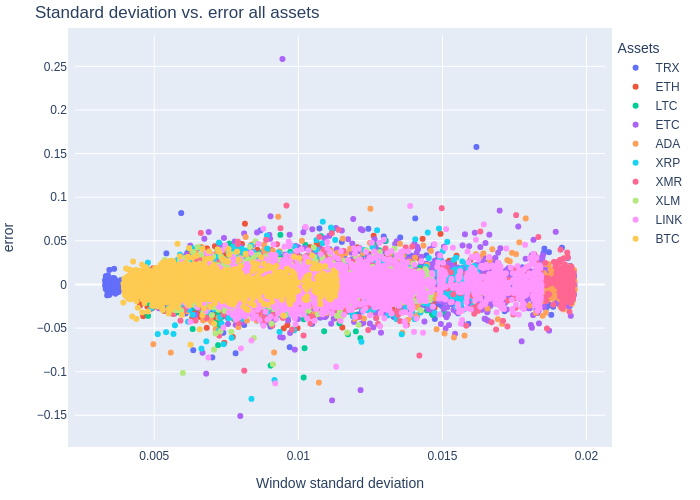

 
-------------------- Error over time per asset --------------------


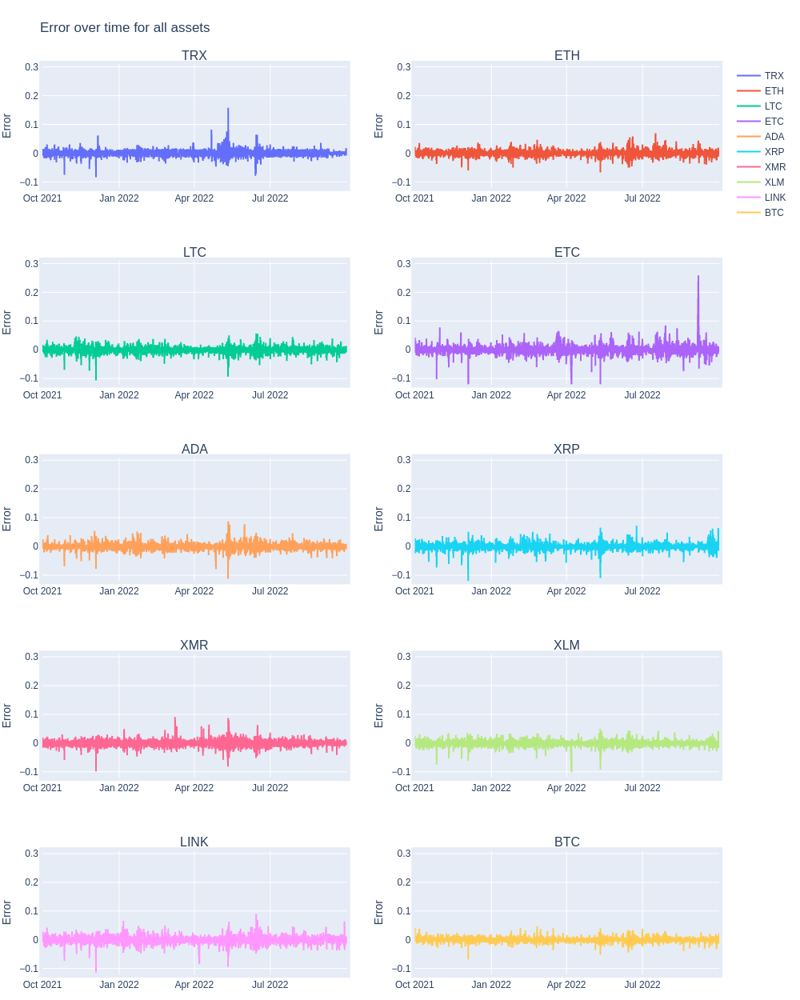

In [62]:
# Error Analysis: 
e = ea.ErrorAnalysis(y_true = list(y_test.reshape(1, -1))[0], y_pred= list(predicted_2.reshape(1, -1))[0], X = test, non_window_columns =["index", "asset", "returns"])
e.report()

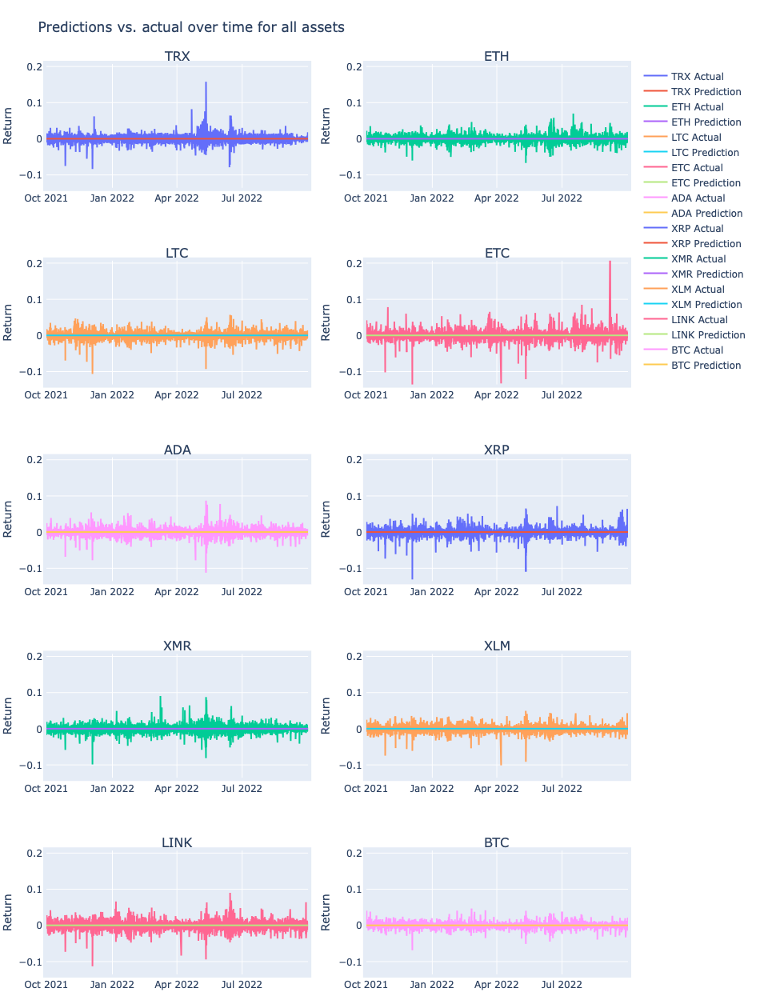

In [63]:
e.predictions()